In [1]:
######Setting GPU environment for tensorflow
%tensorflow_version 2.x
import tensorflow as tf
import timeit

device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  print(
      '\n\nThis error most likely means that this notebook is not '
      'configured to use a GPU.  Change this in Notebook Settings via the '
      'command palette (cmd/ctrl-shift-P) or the Edit menu.\n\n')
  raise SystemError('GPU device not found')

##Importing Libraries:


In [2]:
import tensorflow
import tensorflow.keras, tensorflow.keras.layers as L
from tensorflow.keras.preprocessing import image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

###Unzipping the zip file

In [ ]:
!unzip '/content/drive/My Drive/Avantari/dataset.zip'

##Importing the image files and saving it into an array

In [5]:
mkdir dataset_gray

In [1]:
#rm -rf dataset_gray

In [ ]:
import os,cv2
from skimage import feature

path = '/content/dataset' # Source Folder
dstpath = '/content/dataset_gray' # Destination Folder

files = os.listdir(path)

for image in files:
    img = cv2.imread(os.path.join(path,image))
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    canny = feature.canny(gray, sigma=2.7)
    canny = canny.astype('float32')
    cv2.imwrite(os.path.join(dstpath,image),canny)

####Importing the edge detected images:

In [3]:
import glob
from PIL import Image

images = []
for f in glob.iglob("/content/dataset_gray/*.jpg"):
    images.append(np.asarray(Image.open(f)))

images = np.array(images)

####Importing the color images:

In [4]:
import glob
from PIL import Image

cimages = []
for f in glob.iglob("/content/dataset/*.jpg"):
    cimages.append(np.asarray(Image.open(f)))

cimages = np.array(cimages)

####Viewing any one of the images

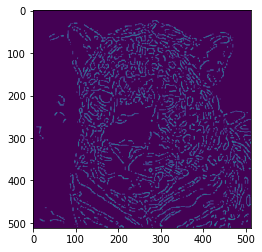

In [5]:
plt.imshow(images[178]);

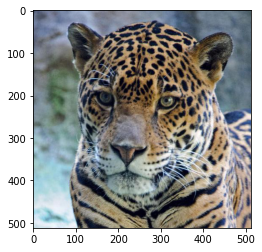

In [6]:
plt.imshow(cimages[178]);

In [7]:
type(images)

numpy.ndarray

In [8]:
images[0].shape

(512, 512)

In [9]:
#Shape of our image array

print('Shape of Image data:', images.shape)

Shape of Image data: (4738, 512, 512)


##Creating an autoencoder using Convolutional layers:

In [10]:
imagess = images.copy()

In [11]:
b = np.reshape(imagess, (4738, 512, 512, -1)) 

In [12]:
b.shape

(4738, 512, 512, 1)

In [13]:
def autoencoder_model(img_shape, code_size):
    H,W,C = img_shape
    
    # encoder
    encoder = tensorflow.keras.models.Sequential()
    encoder.add(L.InputLayer(img_shape))
    
    encoder.add(L.Conv2D(filters=32, kernel_size=(3, 3), activation='elu', padding='same'))
    encoder.add(L.MaxPooling2D(pool_size=(2, 2)))
    encoder.add(L.Conv2D(filters=64, kernel_size=(3, 3), activation='elu', padding='same'))
    encoder.add(L.MaxPooling2D(pool_size=(2, 2)))
    encoder.add(L.Conv2D(filters=128, kernel_size=(3, 3), activation='elu', padding='same'))
    encoder.add(L.MaxPooling2D(pool_size=(2, 2)))
    encoder.add(L.Conv2D(filters=256, kernel_size=(3, 3), activation='elu', padding='same'))
    encoder.add(L.MaxPooling2D(pool_size=(2, 2)))
    encoder.add(L.Flatten())                  #flatten image to vector
    encoder.add(L.Dense(code_size)) 
#     encoder.summary()

    # decoder
    decoder = tensorflow.keras.models.Sequential()
    decoder.add(L.InputLayer((code_size,)))
    
    decoder.add(L.Dense(32*32*256))  #actual decoder, height*width*3 units
    decoder.add(L.Reshape((32,32,256)))
    decoder.add(L.Conv2DTranspose(filters=128, kernel_size=(3, 3), strides=2, activation='elu', padding='same'))
    decoder.add(L.Conv2DTranspose(filters=64, kernel_size=(3, 3), strides=2, activation='elu', padding='same'))
    decoder.add(L.Conv2DTranspose(filters=32, kernel_size=(3, 3), strides=2, activation='elu', padding='same'))
    decoder.add(L.Conv2DTranspose(filters=1, kernel_size=(3, 3), strides=2, activation=None, padding='same'))
    
    return encoder, decoder

In [14]:
IMG_SHAPE = b.shape[1:]
IMG_SHAPE

(512, 512, 1)

In [15]:
##Summary Model for encoder and decoder i.e., our whole autoencoder model

encoder, decoder = autoencoder_model(IMG_SHAPE, code_size=32)
encoder.summary()
decoder.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 512, 512, 32)      320       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 256, 256, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 256, 256, 64)      18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 128, 128, 64)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 128, 128, 128)     73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 64, 64, 128)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 64, 64, 256)       2

In [16]:
inp = L.Input(IMG_SHAPE)
code = encoder(inp)               #encoding
reconstruction = decoder(code)    #decoding
###Giving autoencoder
autoencoder = tensorflow.keras.models.Model(inputs=inp, outputs=reconstruction)
###Compiling our model using adam optimizer
autoencoder.compile(optimizer="adam", loss="mse")

In [17]:
###Fitting our model:

autoencoder.fit(x=images, y=images, epochs=10, verbose=1,batch_size=100,
                callbacks=[tensorflow.keras.callbacks.EarlyStopping(monitor='loss', patience=3),
                           tensorflow.keras.callbacks.ModelCheckpoint('/content/sample_data/autoencoder_{loss:.4f}.h5',
                                                                      save_best_only=True,
                                                                      save_weights_only=False,
                                                                      monitor='loss')])

Epoch 1/10
48/48 [==============================] - 62s 1s/step - loss: 0.0410
Epoch 2/10
48/48 [==============================] - 61s 1s/step - loss: 0.0403
Epoch 3/10
48/48 [==============================] - 61s 1s/step - loss: 0.0400
Epoch 4/10
48/48 [==============================] - 62s 1s/step - loss: 0.0399
Epoch 5/10
48/48 [==============================] - 62s 1s/step - loss: 0.0398
Epoch 6/10
48/48 [==============================] - 62s 1s/step - loss: 0.0397
Epoch 7/10
48/48 [==============================] - 63s 1s/step - loss: 0.0397
Epoch 8/10
48/48 [==============================] - 63s 1s/step - loss: 0.0396
Epoch 9/10
48/48 [==============================] - 63s 1s/step - loss: 0.0396
Epoch 10/10
48/48 [==============================] - 63s 1s/step - loss: 0.0396


In [ ]:
#autoencoder.save('/content/sample_data/autoencoder.h5')

In [18]:
#Loading the saved Autoencoder model

from tensorflow import keras
autoencoder = keras.models.load_model('/content/sample_data/autoencoder_0.0396.h5')

In [19]:
#Encoding our images

#imagess = images[:]
encoded_images = encoder.predict(b)

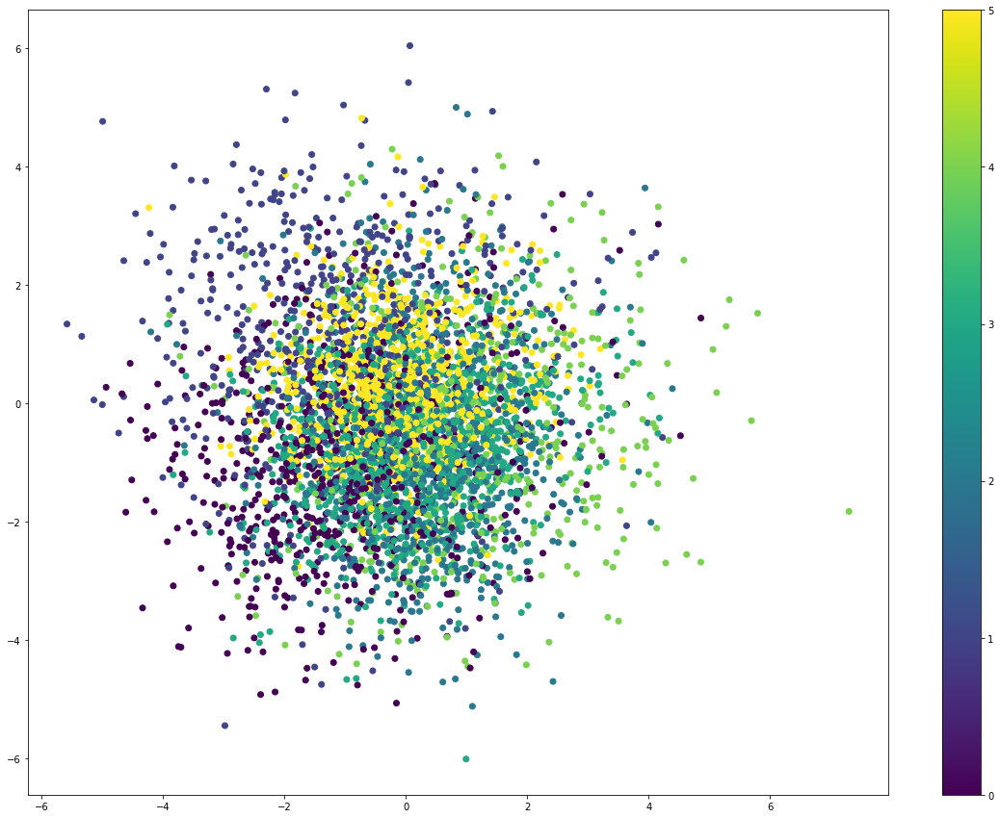

In [20]:
#Clustering using Kmeans:
#Assuming we have 6 classes:e.g. lion, tiger, cheetah, leopard, wolf, fox

from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=6)
kmeans.fit(encoded_images)
plt.figure(figsize=(20, 15))
plt.scatter(encoded_images[:, 0], encoded_images[:, 1], c=kmeans.labels_)
plt.colorbar()
plt.show()

In [21]:
###Fitting our encoded images on Nearest Neighbors algorithms to retrieve similar images

from sklearn.neighbors.unsupervised import NearestNeighbors
nei_clf = NearestNeighbors(metric="euclidean")
nei_clf.fit(encoded_images)

NearestNeighbors(algorithm='auto', leaf_size=30, metric='euclidean',
                 metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                 radius=1.0)

In [22]:
#Function for retrieving distances and indexes of similar images

def get_similar(imag, n_neighbors):
    encoded_image = encoder.predict(imag[None])
    #Getting distances and indexes of nearest neighbors
    (distances,),(idx,) = nei_clf.kneighbors(encoded_image,n_neighbors=n_neighbors)
    
    return distances,cimages[idx]

In [ ]:
#c=b.copy()
#c.shape

In [ ]:
#c = np.reshape(imagess, (4738, 512, 512)) 

In [23]:
#Function for showing similar images:
def show_similar(imag,image,n_neighbors):
    
    distances,neighbors = get_similar(imag,n_neighbors)
    n_neighbor = n_neighbors-1 # for For loop
    dim = round(n_neighbors/2)
    #Plot for original image
    plt.figure(figsize=[50,50])
    plt.subplot(dim,dim,1)
    plt.imshow(image)
    plt.title("Original image")
    #Plot for neighbors
    for i in range(n_neighbor):
        plt.subplot(dim,dim,i+2)
        plt.imshow(neighbors[i+1])
        plt.title("Dist=%.3f"%distances[i+1])
    plt.show()

In [ ]:
####Checking for various species

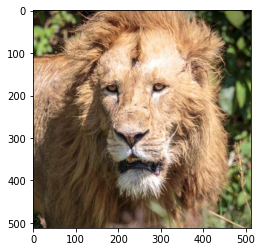

In [24]:
plt.imshow(cimages[0]);

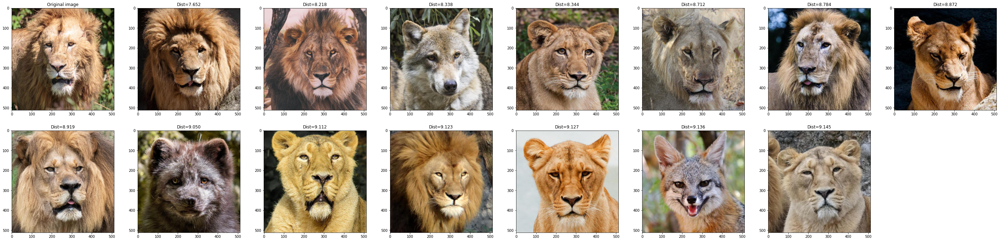

In [25]:
show_similar(b[0],cimages[0],15) #12

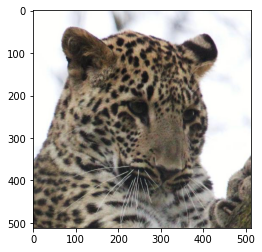

In [26]:
plt.imshow(cimages[209]);

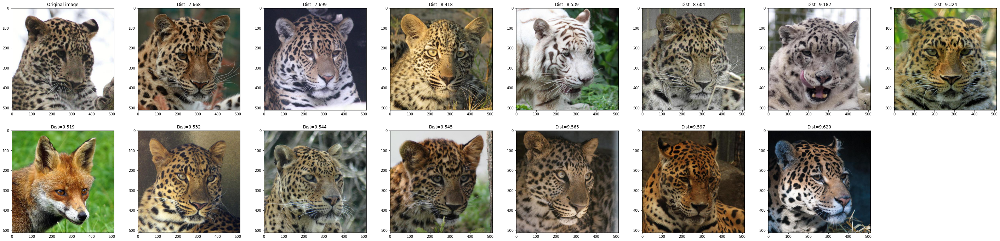

In [27]:
show_similar(b[209],cimages[209],15) #12

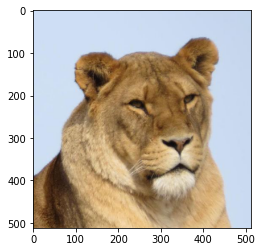

In [28]:
plt.imshow(cimages[99]);

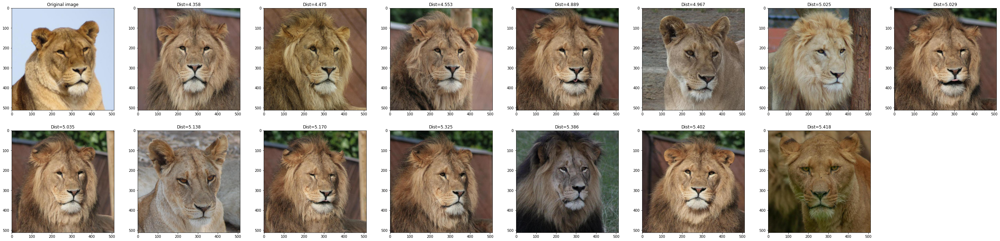

In [30]:
show_similar(b[99],cimages[99],15) #15

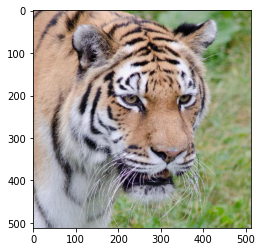

In [48]:
plt.imshow(cimages[1577]); 

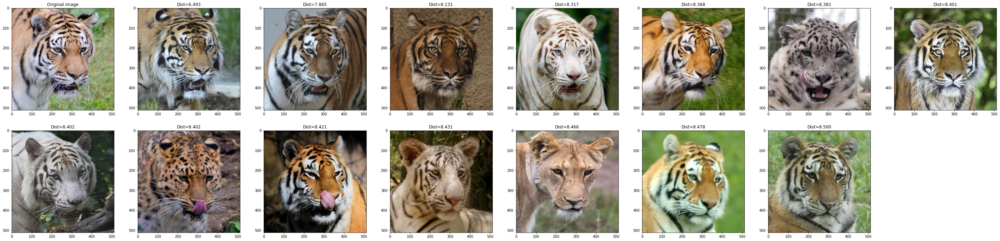

In [49]:
show_similar(b[1577],cimages[1577],15) #13

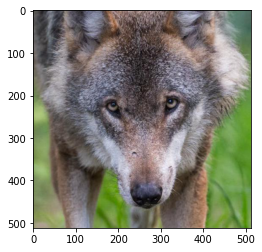

In [40]:
plt.imshow(cimages[57]); 

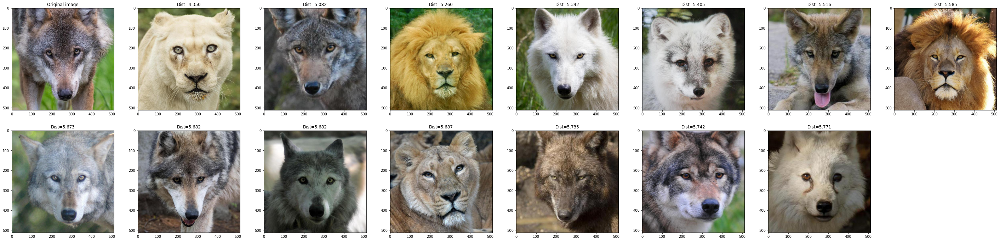

In [41]:
show_similar(b[57],cimages[57],15) #10

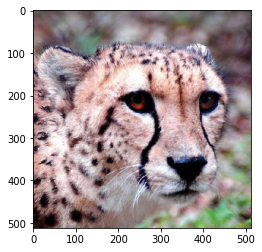

In [62]:
plt.imshow(cimages[]);

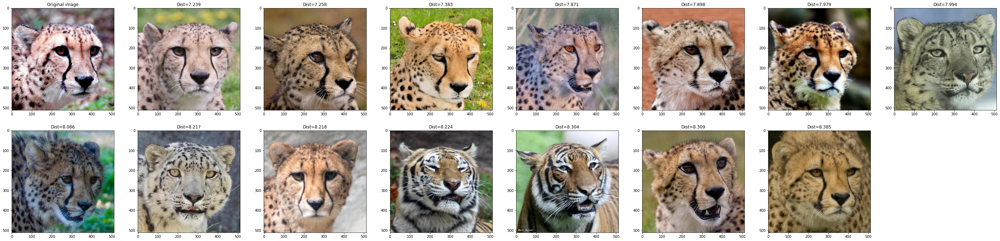

In [63]:
show_similar(b[335],cimages[335],15) #11

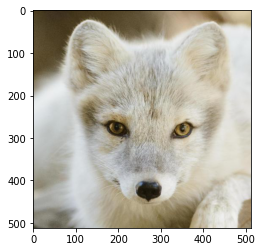

In [70]:
plt.imshow(cimages[3]);

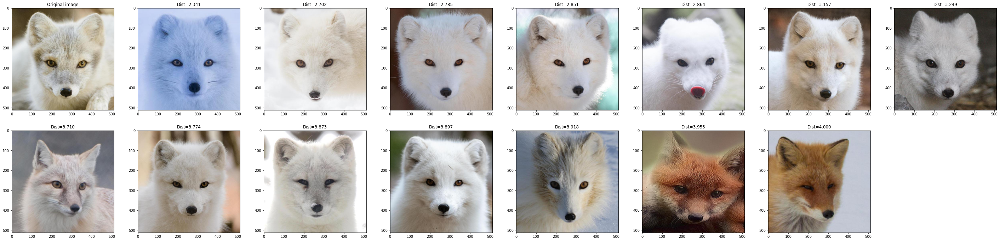

In [72]:
show_similar(b[3],cimages[3],15) #15